In [7]:
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from scipy import stats

In [8]:
embeddings_for_percentile_comp = np.squeeze(np.load('alexnet_imgnet_embeddings_prelu.npy'))
sub_embeddings_for_percentile_comp = np.squeeze(np.load('alexnet_imgnet_sub_embeddings_prelu.npy'))

cumulative_embedding_output_1_random = np.load('cumulative_embedding_output_1_random.npy')[:1000,:]
cumulative_sub_embedding_output_1_random = np.load('cumulative_sub_embedding_output_1_random.npy')[:1000,:]

cumulative_embedding_output_2_random = np.load('cumulative_embedding_output_2_random.npy')[:1000,:]
cumulative_sub_embedding_output_2_random = np.load('cumulative_sub_embedding_output_2_random.npy')[:1000,:]

cumulative_embedding_output_1_dogs = np.load('cumulative_embedding_output_1_dogs.npy')[:1000,:]
cumulative_sub_embedding_output_1_dogs = np.load('cumulative_sub_embedding_output_1_dogs.npy')[:1000,:]

cumulative_embedding_output_2_dogs = np.load('cumulative_embedding_output_2_dogs.npy')[:1000,:]
cumulative_sub_embedding_output_2_dogs = np.load('cumulative_sub_embedding_output_2_dogs.npy')[:1000,:]

In [9]:
embeddings_for_percentile_comp= np.squeeze(np.load('alexnet_imgnet_embeddings_prelu_noise.npy'))


sorted_indices_embedding = np.argsort(embeddings_for_percentile_comp,axis = 0)

indices_90_embedding = sorted_indices_embedding[900,:]

embedding_threshold_90 = embeddings_for_percentile_comp[indices_90_embedding, range(4096)]


embeddings_for_percentile_comp = np.squeeze(np.load('alexnet_imgnet_sub_embeddings_prelu_noise.npy'))

sorted_indices_sub_embedding = np.argsort(sub_embeddings_for_percentile_comp,axis = 0)

indices_90_sub_embedding = sorted_indices_sub_embedding[900,:]

sub_embedding_threshold_90 = sub_embeddings_for_percentile_comp[indices_90_sub_embedding, range(4096)]


In [11]:
plt.figure(figsize=(20,10))

random_active_1 = (cumulative_embedding_output_1_random >= embedding_threshold_90)*1
random_active_2= (cumulative_embedding_output_2_random >= embedding_threshold_90)*1

co_active_features_random = random_active_1*random_active_2
num_co_active_random = np.sum(co_active_features_random, axis=1)
co_active_average_random = np.sum(co_active_features_random)/1000 


dog_active_1 = (cumulative_embedding_output_1_dogs >= embedding_threshold_90)*1
dog_active_2 = (cumulative_embedding_output_2_dogs >= embedding_threshold_90)*1


co_active_features_dog = dog_active_1*dog_active_2
num_co_active_dog = np.sum(co_active_features_dog, axis=1)
co_active_average_dog = np.sum(co_active_features_dog)/1000


sorted_num_co_active_dog = np.argsort(-num_co_active_dog)
sorted_num_co_active_random = np.argsort(-num_co_active_random)


<Figure size 1440x720 with 0 Axes>

# top-10 random image pairs with most co-active embedding features

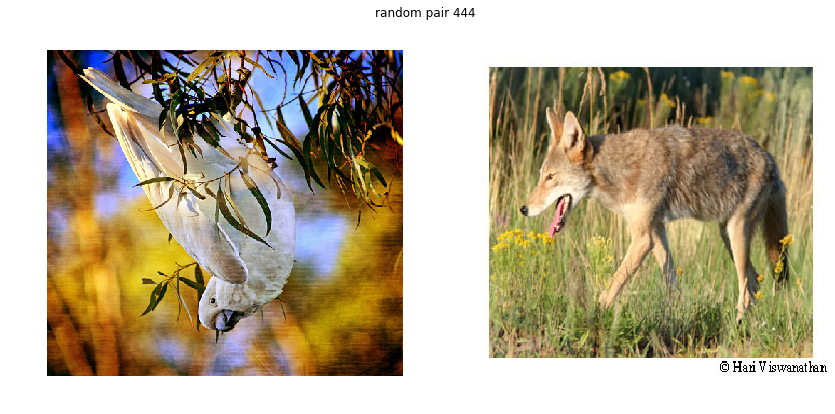

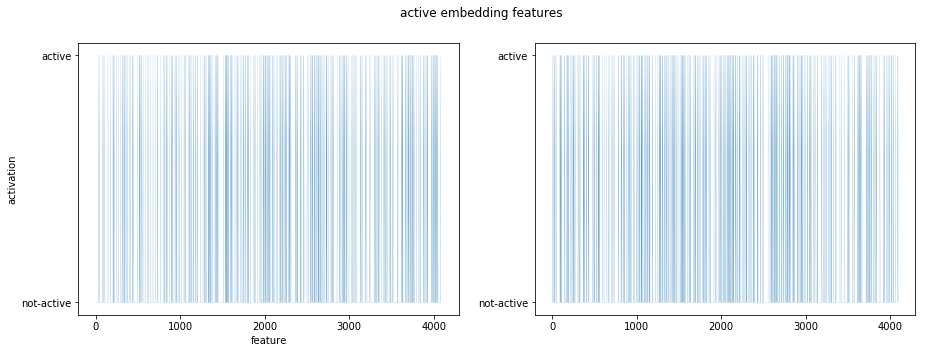

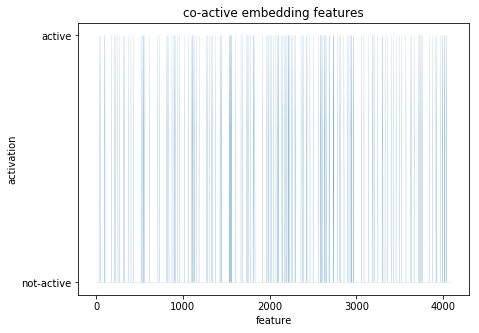

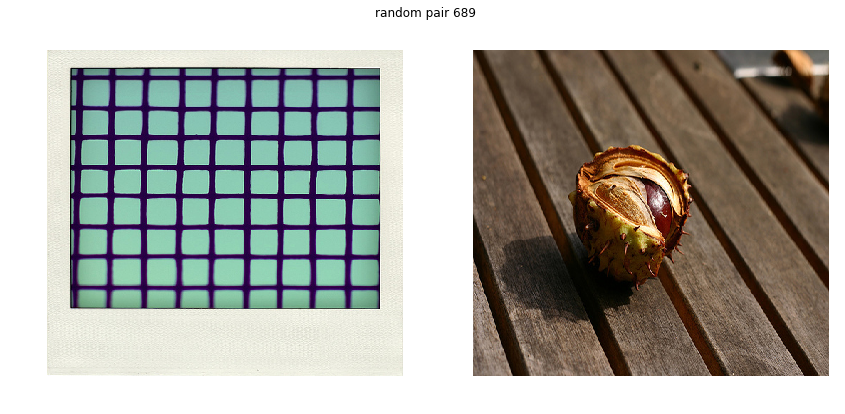

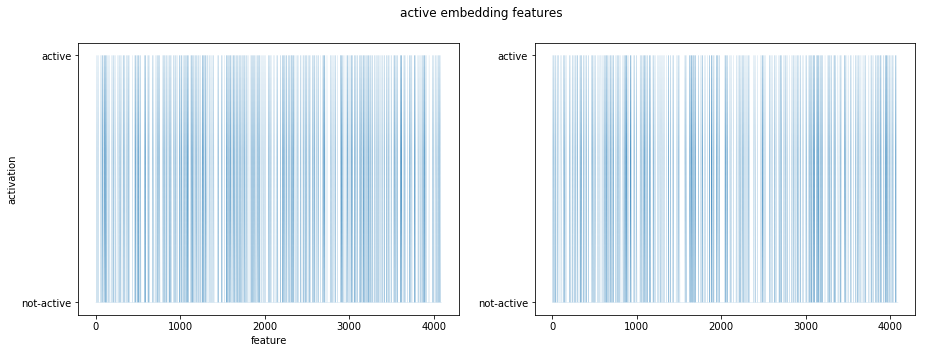

...

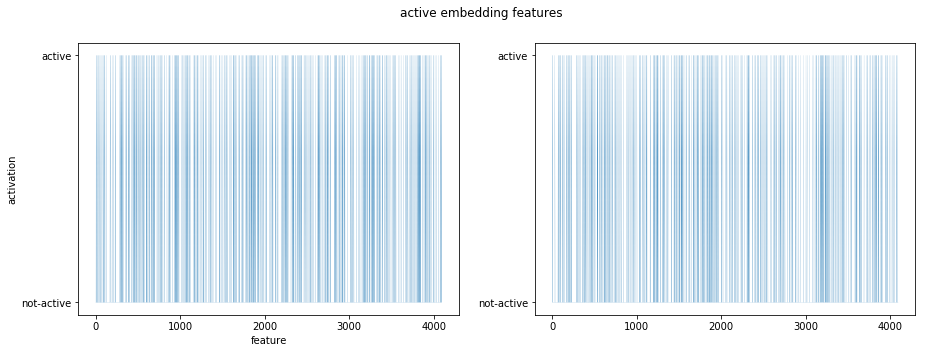

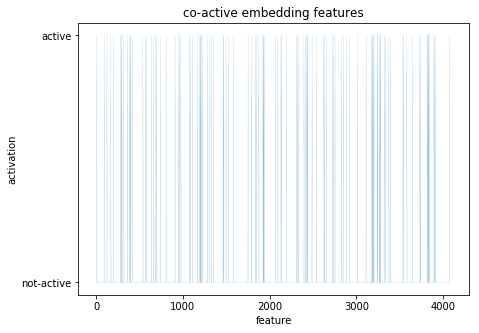

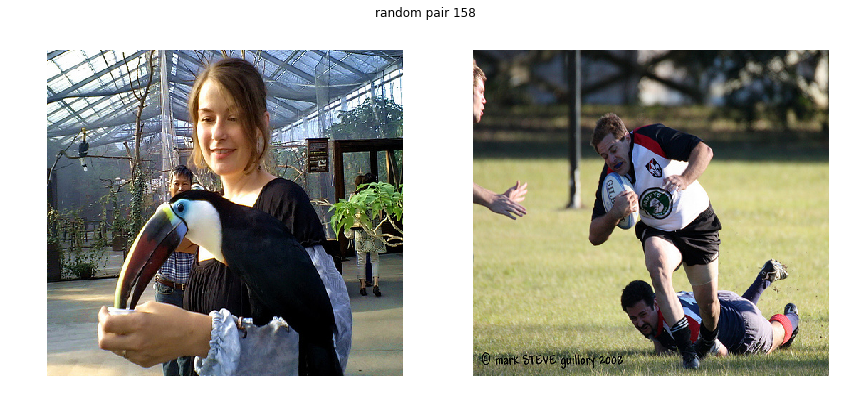

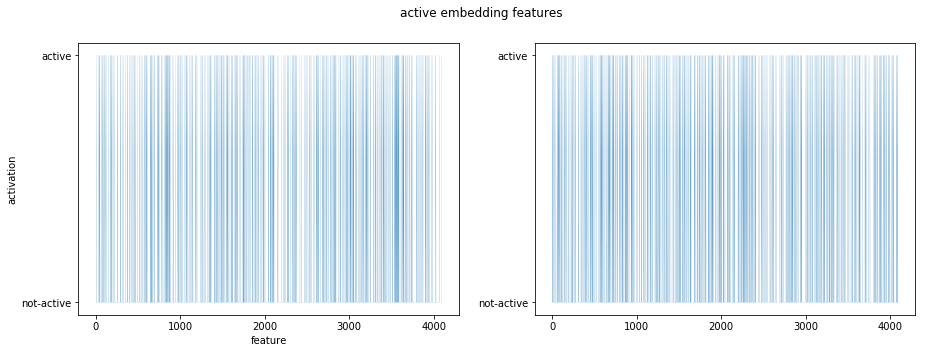

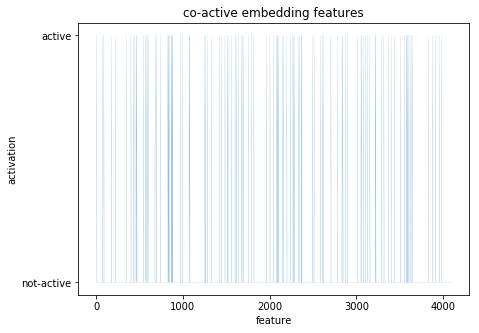

In [26]:
count = 0
for index in sorted_num_co_active_random:
    img1 = mpimg.imread('random_pairs/'+'count_'+str(index)+'/1.jpg')
    img2 = mpimg.imread('random_pairs/'+'count_'+str(index)+'/2.jpg')
     
    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(14,6))
    fig.suptitle('random pair '+str(index))
    ax1.imshow(img1,aspect = 'auto')
    ax1.axis('off')
    ax2.imshow(img2, aspect = 'auto')
    ax1.set_xlabel('feature')
    ax1.set_ylabel('activation')
    plt.axis('off')
    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(15,5))
    ax1.plot(random_active_1[index,:], linewidth=0.1)
    ax2.plot(random_active_2[index,:], linewidth=0.1)
    ax1.set_xlabel('feature')
    ax1.set_ylabel('activation')
    ax1.set_yticks([0,1])
    ax1.set_yticklabels(['not-active', 'active'])
    ax2.set_yticks([0,1])
    ax2.set_yticklabels(['not-active', 'active'])
    fig.suptitle('active embedding features ')
    plt.show()
    plt.title('co-active embedding features')
    plt.close()
    plt.figure(figsize=(7,5))
    plt.plot(co_active_features_random[index,:], linewidth=0.1)
    plt.title('co-active embedding features')
    plt.xlabel('feature')
    plt.ylabel('activation')
    plt.yticks([0,1], labels = ['not-active', 'active'])
    plt.title('co-active embedding features')
    plt.show()
    count += 1
    if count == 10:
        break


# top-10 dog image pairs with most co-active embedding features

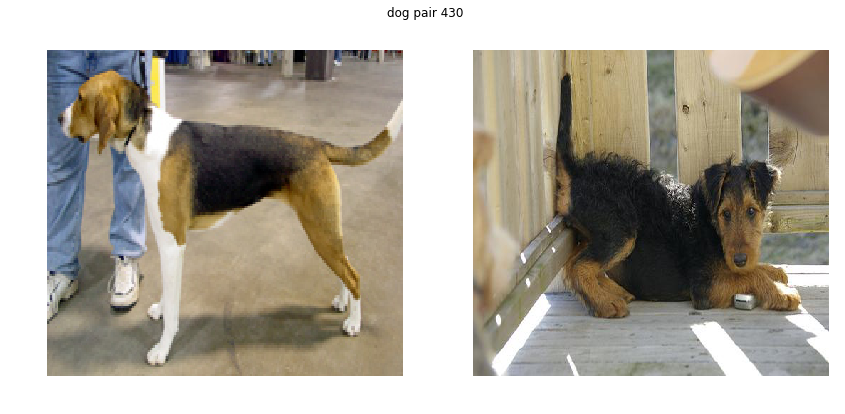

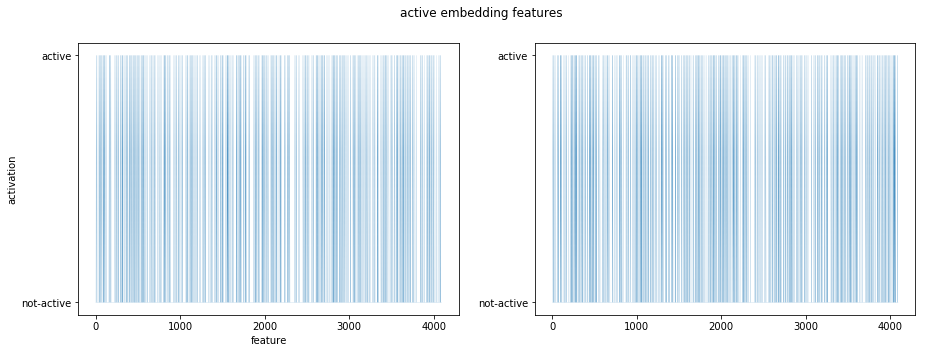

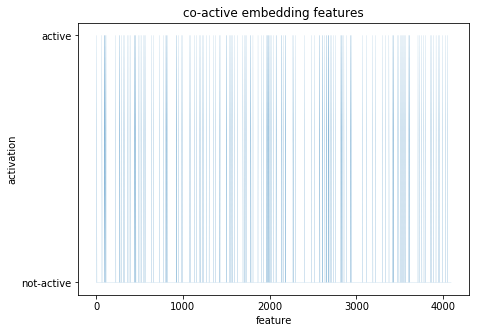

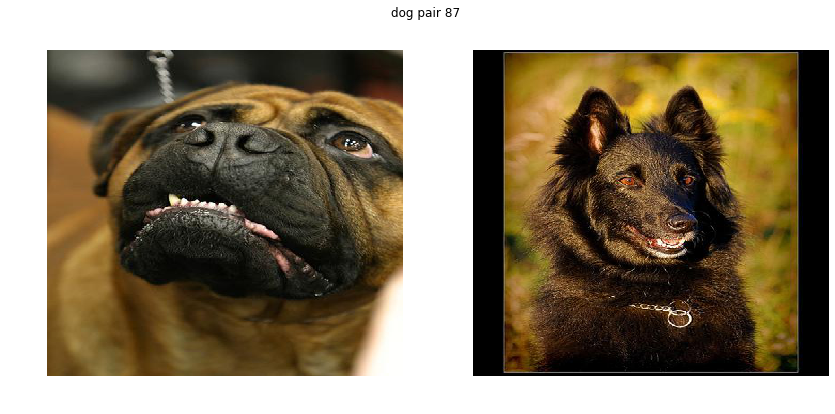

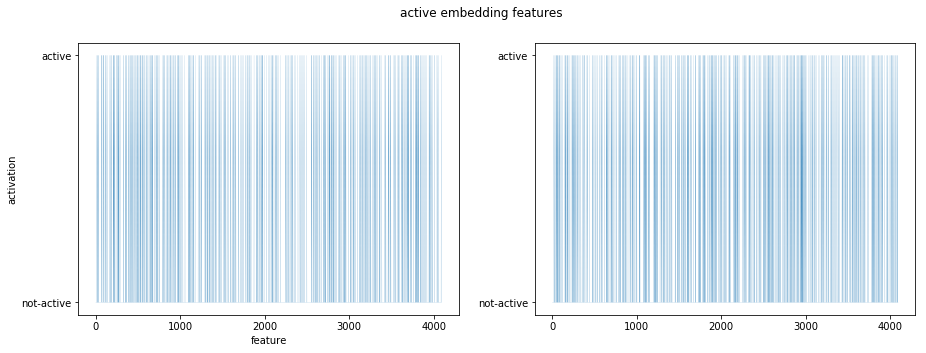

...

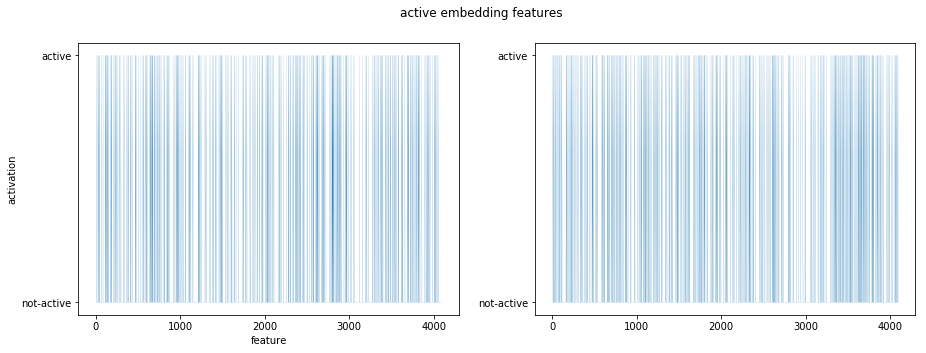

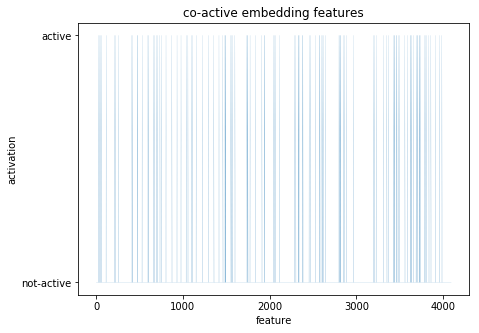

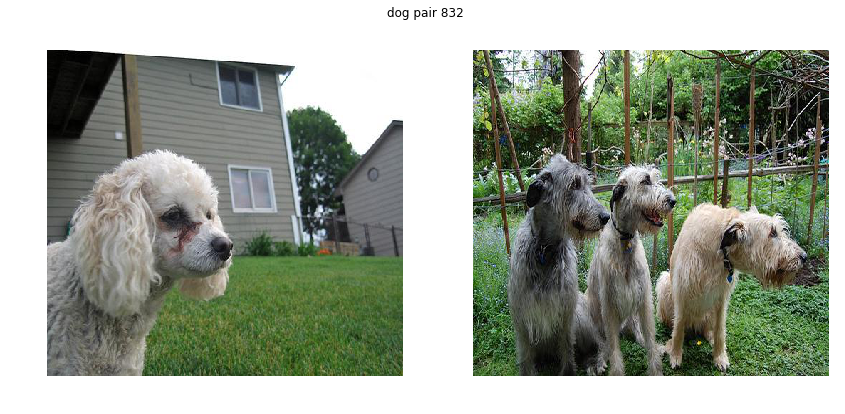

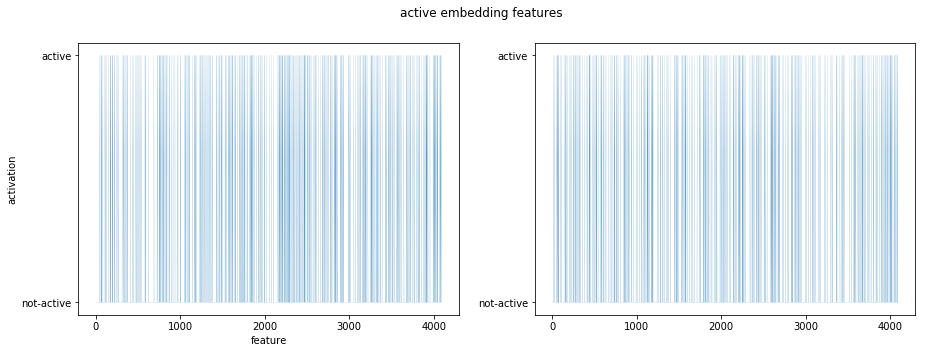

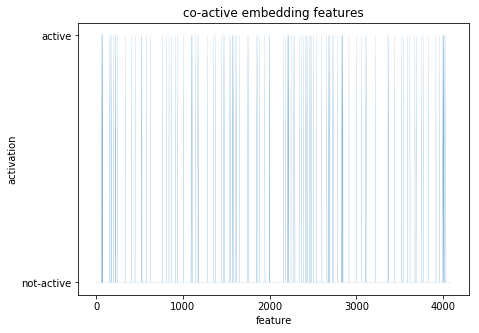

In [25]:
count = 0
for index in sorted_num_co_active_dog:
    img1 = mpimg.imread('dog_pairs/'+'count_'+str(index)+'/1.jpg')
    img2 = mpimg.imread('dog_pairs/'+'count_'+str(index)+'/2.jpg')
     
    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(14,6))
    fig.suptitle('dog pair '+str(index))
    ax1.imshow(img1,aspect = 'auto')
    ax1.axis('off')
    ax2.imshow(img2, aspect = 'auto')
    ax1.set_xlabel('feature')
    ax1.set_ylabel('activation')
    plt.axis('off')
    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(15,5))
    ax1.plot(dog_active_1[index,:], linewidth=0.1)
    ax2.plot(dog_active_2[index,:], linewidth=0.1)
    ax1.set_xlabel('feature')
    ax1.set_ylabel('activation')
    ax1.set_yticks([0,1])
    ax1.set_yticklabels(['not-active', 'active'])
    ax2.set_yticks([0,1])
    ax2.set_yticklabels(['not-active', 'active'])
    fig.suptitle('active embedding features ')
    plt.show()
    plt.title('co-active embedding features')
    plt.close()
    plt.figure(figsize=(7,5))
    plt.plot(co_active_features_dog[index,:], linewidth=0.1)
    plt.title('co-active embedding features')
    plt.xlabel('feature')
    plt.ylabel('activation')
    plt.yticks([0,1], labels = ['not-active', 'active'])
    plt.title('co-active embedding features')
    plt.show()
    count += 1
    if count == 10:
        break


In [32]:
import matplotlib.pyplot as plt

plt.figure(figsize=(20,10))

random_active_1_sub = (cumulative_sub_embedding_output_1_random >= sub_embedding_threshold_90)*1
random_active_2_sub = (cumulative_sub_embedding_output_2_random >= sub_embedding_threshold_90)*1


co_active_features_random_sub = random_active_1_sub*random_active_2_sub
num_co_active_random = np.sum(co_active_features_random_sub, axis=1)
co_active_average_random_sub = np.sum(co_active_features_random_sub)/1000 

dog_active_1_sub = (cumulative_sub_embedding_output_1_dogs >= sub_embedding_threshold_90)*1
dog_active_2_sub = (cumulative_sub_embedding_output_2_dogs >= sub_embedding_threshold_90)*1


co_active_features_dogs_sub = dog_active_1_sub*dog_active_2_sub
num_co_active_dog = np.sum(co_active_features_dogs_sub, axis=1)
co_active_average_dog_sub = np.sum(co_active_features_dogs_sub)/1000


sorted_num_co_active_dog = np.argsort(-num_co_active_dog)
sorted_num_co_active_random = np.argsort(-num_co_active_random)

<Figure size 1440x720 with 0 Axes>

# top-10 random image pairs with most co-active sub-embedding features

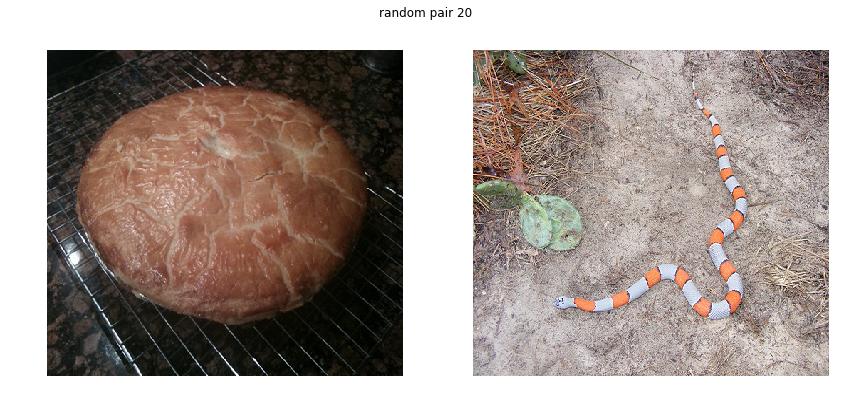

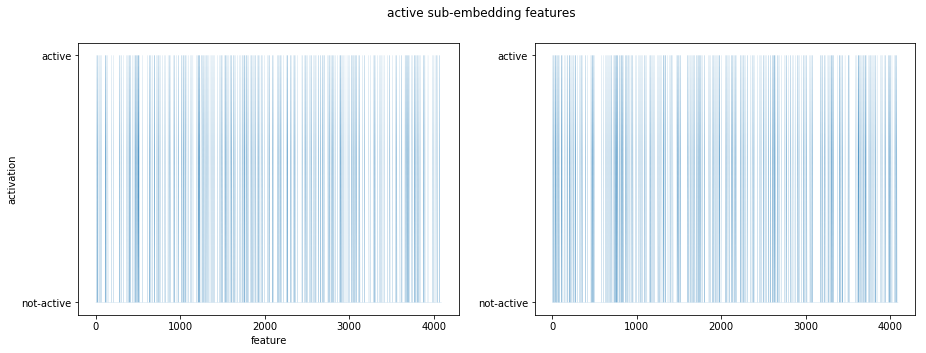

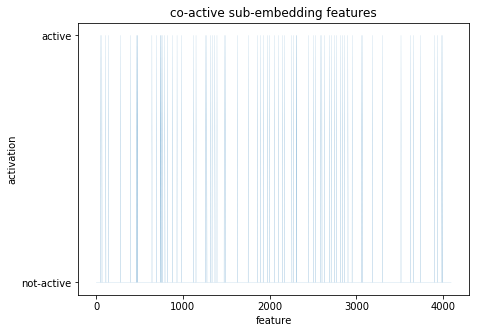

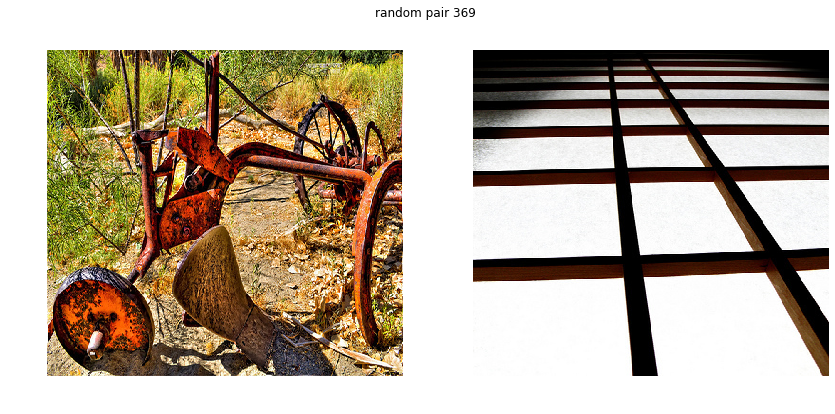

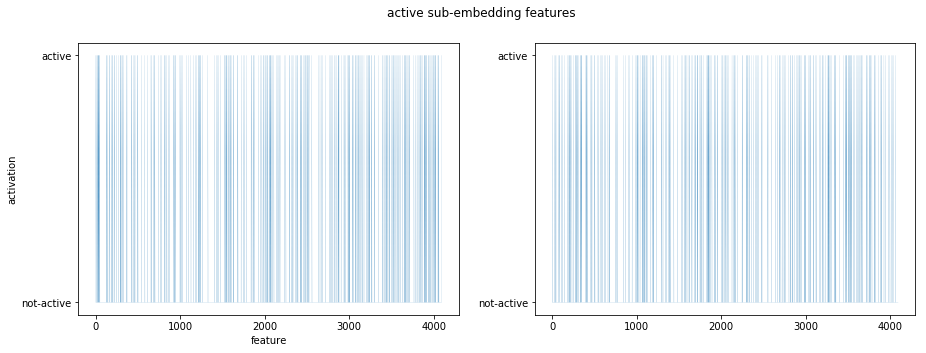

...

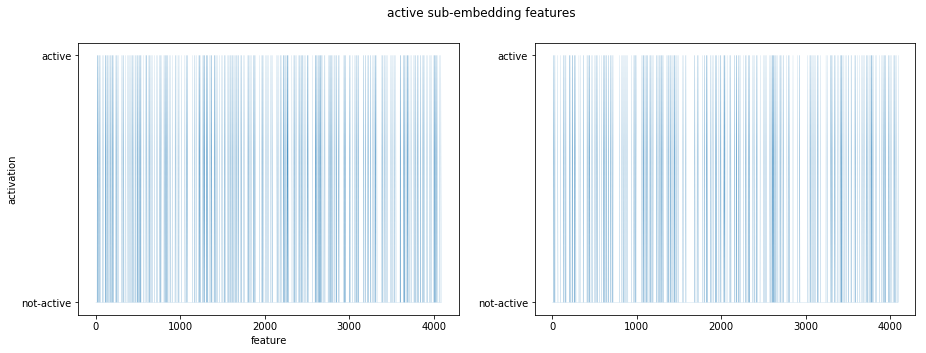

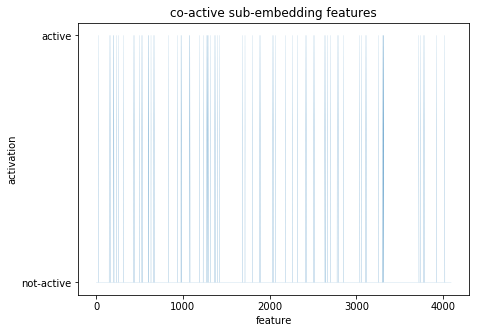

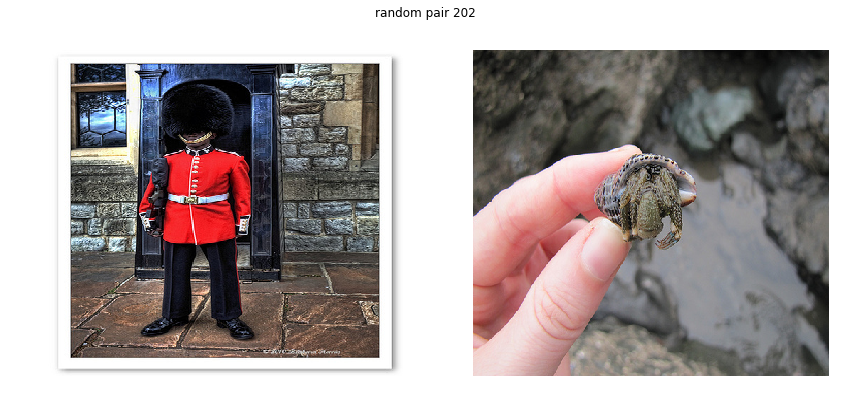

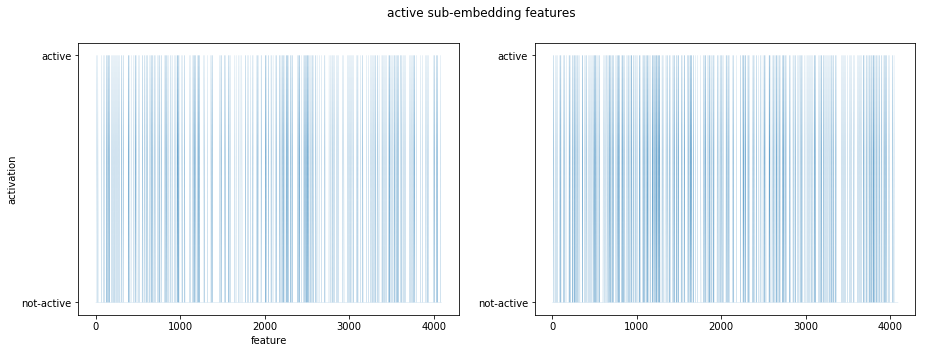

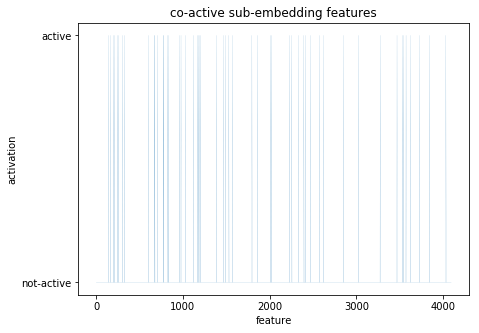

In [33]:
count = 0
for index in sorted_num_co_active_random:
    img1 = mpimg.imread('random_pairs/'+'count_'+str(index)+'/1.jpg')
    img2 = mpimg.imread('random_pairs/'+'count_'+str(index)+'/2.jpg')
    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(14,6))
    fig.suptitle('random pair '+str(index))
    ax1.imshow(img1,aspect = 'auto')
    ax1.axis('off')
    ax2.imshow(img2, aspect = 'auto')
    ax1.set_xlabel('feature')
    ax1.set_ylabel('activation')
    plt.axis('off')
    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(15,5))
    ax1.plot(random_active_1[index,:], linewidth=0.1)
    ax2.plot(random_active_2[index,:], linewidth=0.1)
    ax1.set_xlabel('feature')
    ax1.set_ylabel('activation')
    ax1.set_yticks([0,1])
    ax1.set_yticklabels(['not-active', 'active'])
    ax2.set_yticks([0,1])
    ax2.set_yticklabels(['not-active', 'active'])
    fig.suptitle('active sub-embedding features ')
    plt.show()
    plt.title('co-active sub-embedding features')
    plt.close()
    plt.figure(figsize=(7,5))
    plt.plot(co_active_features_random[index,:], linewidth=0.1)
    plt.title('co-active sub-embedding features')
    plt.xlabel('feature')
    plt.ylabel('activation')
    plt.yticks([0,1], labels = ['not-active', 'active'])
    plt.title('co-active sub-embedding features')
    plt.show()
    count += 1
    if count == 10:
        break


# top-10 dog image pairs with most co-active sub-embedding features

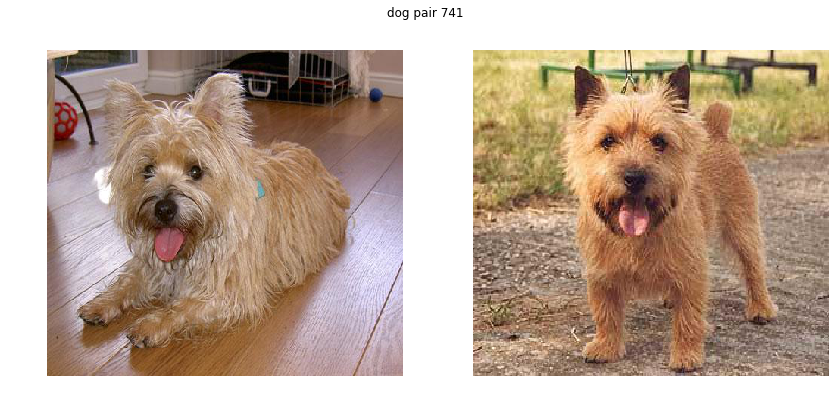

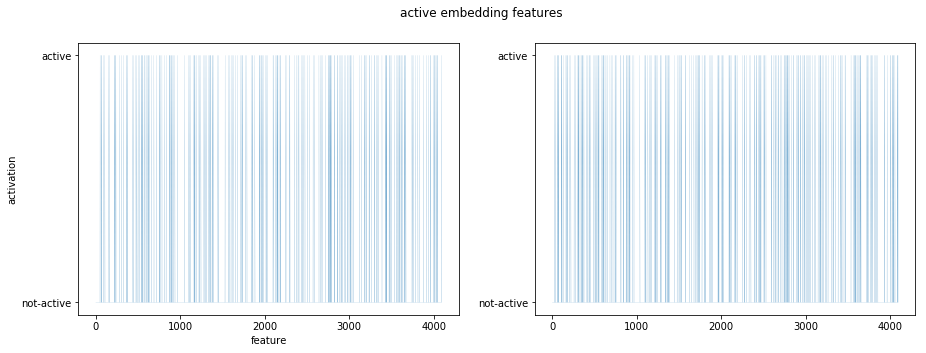

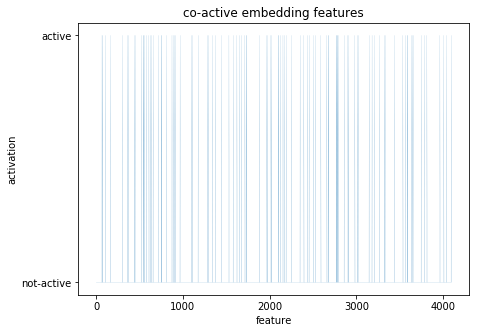

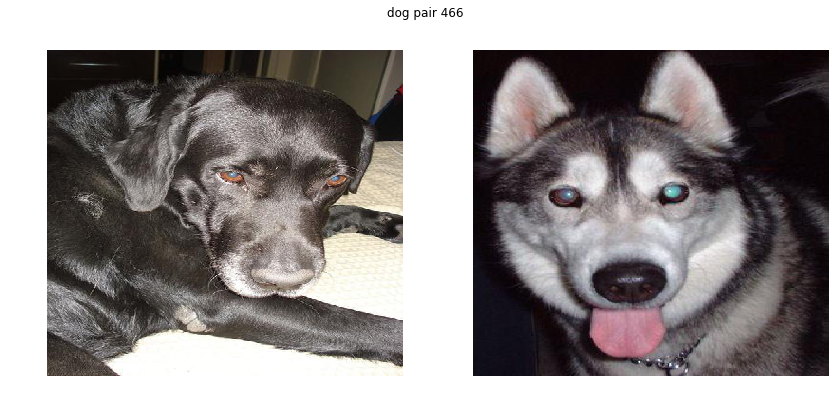

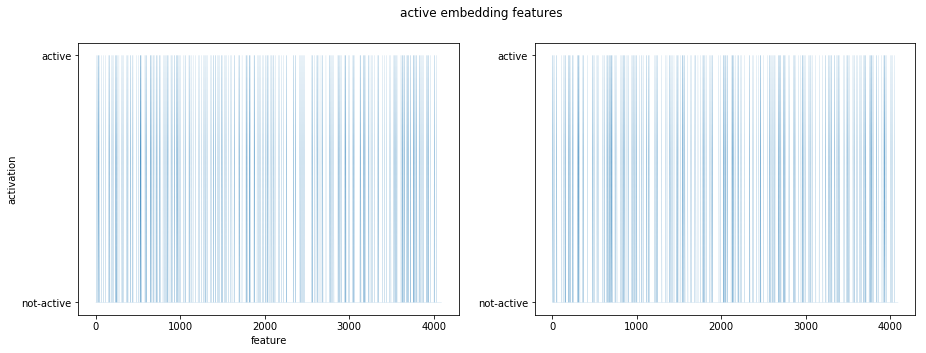

...

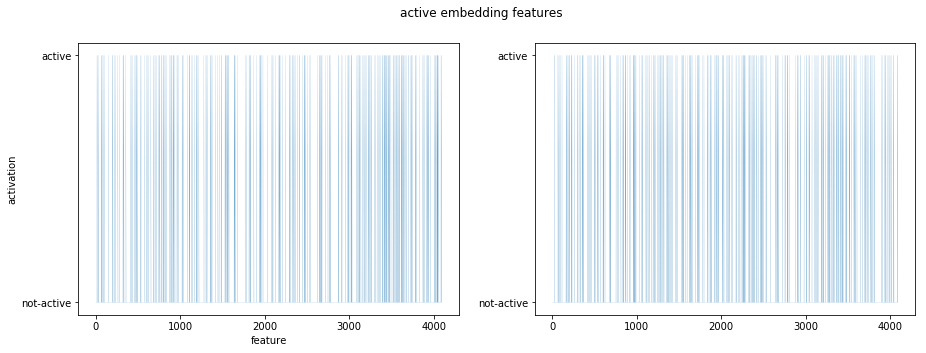

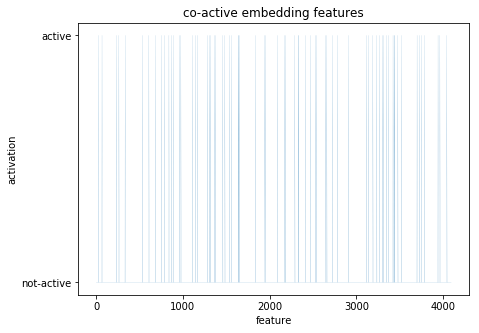

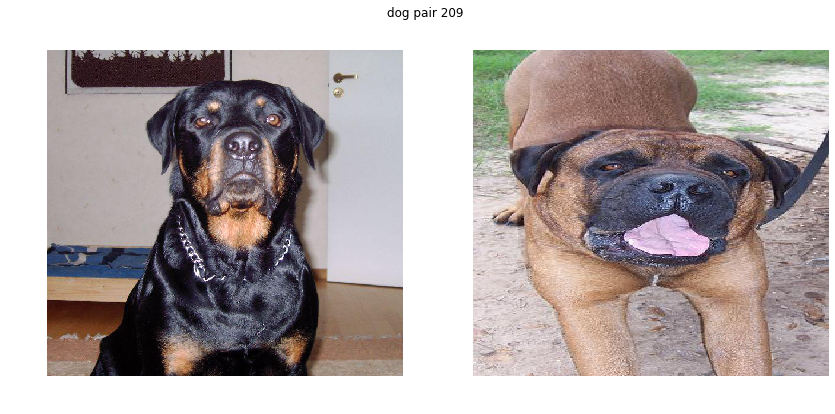

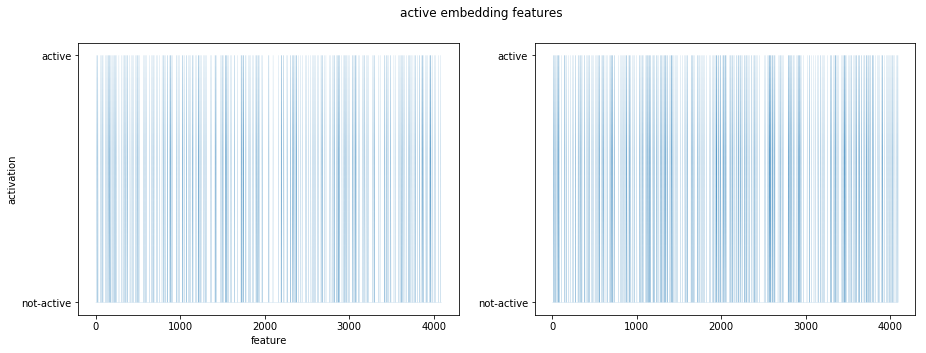

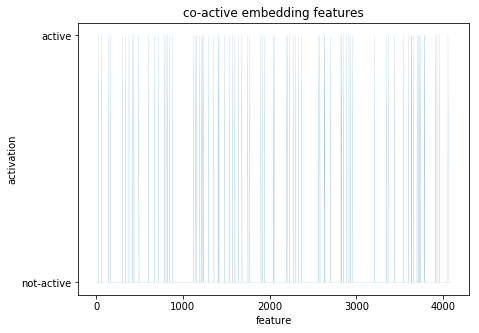

In [34]:
count = 0
for index in sorted_num_co_active_dog:
    img1 = mpimg.imread('dog_pairs/'+'count_'+str(index)+'/1.jpg')
    img2 = mpimg.imread('dog_pairs/'+'count_'+str(index)+'/2.jpg')
     
    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(14,6))
    fig.suptitle('dog pair '+str(index))
    ax1.imshow(img1,aspect = 'auto')
    ax1.axis('off')
    ax2.imshow(img2, aspect = 'auto')
    ax1.set_xlabel('feature')
    ax1.set_ylabel('activation')
    plt.axis('off')
    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(15,5))
    ax1.plot(dog_active_1[index,:], linewidth=0.1)
    ax2.plot(dog_active_2[index,:], linewidth=0.1)
    ax1.set_xlabel('feature')
    ax1.set_ylabel('activation')
    ax1.set_yticks([0,1])
    ax1.set_yticklabels(['not-active', 'active'])
    ax2.set_yticks([0,1])
    ax2.set_yticklabels(['not-active', 'active'])
    fig.suptitle('active embedding features ')
    plt.show()
    plt.title('co-active embedding features')
    plt.close()
    plt.figure(figsize=(7,5))
    plt.plot(co_active_features_dog[index,:], linewidth=0.1)
    plt.title('co-active embedding features')
    plt.xlabel('feature')
    plt.ylabel('activation')
    plt.yticks([0,1], labels = ['not-active', 'active'])
    plt.title('co-active embedding features')
    plt.show()
    count += 1
    if count == 10:
        break
